In [1]:
import osmnx as ox
import geopandas as gpd
import osmium
import time
import pandas as pd
import numpy as np
import shapely.wkb as wkblib
import shapely.wkt

from PIL import Image, ImageDraw, ImageFont

from shapely import affinity
from shapely.geometry import Point, LineString
from rtree import index
from matplotlib.lines import Line2D

from keplergl import KeplerGl 

from utils import add_border

######## CONSTANTS
img_path_temp = 'Berlin_temp.png'
img_path_final = 'Berlin_temp.png'
ALCOHOL_DIST_THRS_M = 500

OSMNx_city_query = 'berlin, germany'

######## FILES
# PBF_PATH obtained from https://download.geofabrik.de/europe/germany/berlin-latest.osm.pbf
PBF_PATH = 'berlin-latest.osm.pbf' 

# Getting the data

All the information we'll get will be from Open Street Maps - OSM - https://www.openstreetmap.org/  
  
This is an open source platform containing geographic data and also a source for a variety of open source tools, such as:
* Router: http://project-osrm.org/
* Geocoder: https://nominatim.org/ - https://nominatim.openstreetmap.org/
* Humanitarian Acts Platform: https://www.hotosm.org/  

Check the links for more informations :)  

For our maps, we need two types of data:  
* Street Network: Graph
* Points of interest: Points - Pairs of Latitude/Longitude, together with their metadata.
  
## Street Network
  
For the street network, we will obtain them from OSMNx - https://geoffboeing.com/2016/11/osmnx-python-street-networks/ (Open Street Maps + NetworkX).  

An important detail in the function we're going to use is that it access OSM's geocoder - Nominatin - to convert a string to a polygon, from which OSMNx will extract the roads' network.
For some cities, Nominatin just doesn't return a polygon on it's first result, one of the necessary condititions for OSMNx function to work. Give it a test at nominatin between "berlin, germany" and "hamburg, germany".  
  
* The obtained data structure will be a graph (NetworkX) structure, with edges being the street segments and their names and metadata - https://wiki.openstreetmap.org/wiki/Way.  
  
    
* For more explanations on the data types from OSM and how OSM represent the world with it, please check https://github.com/caiomiyashiro/geospatial_data_analysis/blob/master/AMLD-2020/Complete_AMLD_2020.ipynb on "OSM Data Representation".

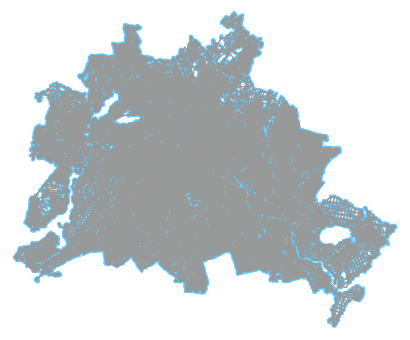

In [2]:
# https://nominatim.openstreetmap.org/
G = ox.core.graph_from_place(OSMNx_city_query, simplify=True)
fig, ax = ox.plot_graph(G)

# you can try this out to see the error
# G = ox.core.graph_from_place('hamburg, germany', simplify=True)
# fig, ax = ox.plot_graph(G)

# Points of Interest - POI

OSMNx helps us by providing an abstraction to easily obtain street networks from Python, but it doesn't retrieve any extra data that we might need, such as POIs for our map.  

In order to get OSM data in a complete way, we can access geofabrik's free service on map data - http://download.geofabrik.de/.   
  
* They process OSM data in a periodic way in order to aways provide up to date map data.  
  
  
* Their completeness can be checked on their own manual on what are the things we can find in their data - http://download.geofabrik.de/osm-data-in-gis-formats-free.pdf  

Lastly, we need some code to extract the data points that are actually relevant for us. For that we'll use pyosmium - https://osmcode.org/pyosmium/ - a tool to process the data format that is used by OSM and geofabrik - `osm.pbf`.  
  
Below, we define a class to process the pbf file and process only nodes, which can contain our POIs. For example, the same `ways` that OSMNx processed before hand can also be found on this file, but we choose not to look at them, as OSMNx process them in a better way.  

* We'll process the file and save the resulting nodes as a csv, as reading and processing the pbf takes a loooong time.

In [3]:
%%time

class Pyosmium(osmium.SimpleHandler):          # class must inherit from osmium.SimpleHandler
    def __init__(self, pbf_path):
        osmium.SimpleHandler.__init__(self)        # initialize pyosmium
        self.names = []                            # store points names
        self.amenities = []
        self.wkb_fab = osmium.geom.WKBFactory()    # builds geometry over OSM objects
        self.points = []                           # store points geometries
        self.lats = []                           
        self.longs = []                           
            
        print('loading/processing pbf file...')
        self.apply_file(pbf_path, locations=True)  # initialize osm.pbf file process
        self.df = pd.DataFrame({'name': self.names, 'amenity': self.amenities, 
                                'point': self.points, 'lat': self.lats, 'long': self.longs}) # convert all data to DataFrame
        
        
    def node(self, node):
        # TagList can't be converted to dict automatically, see:
        # https://github.com/osmcode/pyosmium/issues/106
        tags_dict = {tag.k: tag.v for tag in node.tags}
        wkb = self.wkb_fab.create_point(node)   # extract Point's hex location data
        points = wkblib.loads(wkb, hex=True)    # convert hex data to WKB geometry format
        self.points.append(points)              # store geometry in list
        self.lats.append(points.xy[1][0])
        self.longs.append(points.xy[0][0])
        self.amenities.append(tags_dict['amenity'] if 'amenity' in tags_dict.keys() else '')
        self.names.append(tags_dict['name'] if 'name' in tags_dict.keys() else '') 
            
berlin_pyosmium = Pyosmium(PBF_PATH)
berlin_pyosmium.df.to_csv('berlin_nodes.csv', index=False)


loading/processing pbf file...
CPU times: user 12min 36s, sys: 10.7 s, total: 12min 46s
Wall time: 12min 58s


Next, we look at all the nodes we collect and only keep the ones who serves our purpose, in this case, that we can obtain ANY kind of alcohol!  
  
  
* Notice the last 4 commands. As we will play with geographic data, we will work with a geodataframe. Geodataframes are exactly the same as regular Pandas Dataframes, but they have one last column containing a specific type of data called `geometry` that geopandas can play with.

In [4]:
%%time
df = pd.read_csv('berlin_nodes.csv')

# list of places that we potentially find alcohol
# list of possible places: https://wiki.openstreetmap.org/wiki/Key:amenity
nice_amenities = ['restaurant', 'fuel', 'fast_food', 'cafe', 
                  'pub', 'bar', 'biergarten', 'nightclub', 'brothel',
                  'hookah_lounge']

nice_amenities = df.loc[df['amenity'].isin(nice_amenities)].copy()
# technical step to convert a string containing the lat/long to a geometric object that python can understand
nice_amenities['point'] = nice_amenities['point'].apply(lambda elem: shapely.wkt.loads(elem))

nice_amenities = gpd.GeoDataFrame(nice_amenities, geometry='point')
nice_amenities.crs = {'init' :'epsg:4326'}

nice_amenities.head()

CPU times: user 10.9 s, sys: 5.33 s, total: 16.2 s
Wall time: 17.7 s


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


,name,amenity,point,lat,long
367,Aral,fuel,POINT (13.34544 52.54644),52.546440,13.345439
2907,Aida,restaurant,POINT (13.32282 52.50691),52.506911,13.322821
2910,Madame Ngo,restaurant,POINT (13.31808 52.50621),52.506212,13.318081
2911,Lemongrass,restaurant,POINT (13.32078 52.50732),52.507320,13.320780
4009,Aral,fuel,POINT (13.32819 52.53082),52.530825,13.328194


Now that we have all our needed data, we can start processing it.  
  
In order to define what color which street is going to have, we will do the following steps:  
  
1. Expand each point of interest in 500 meters of radius - the number 500 is a constant parameter
2. for each street, count how many it intersects with any of the expanded points of interest
3. Define color and street width bins for the counts
4. Plot!

# Buffer points to alcohol distance


In [5]:
%%time
# projection trick to buffer geometries in 'meters' unit
nice_amenities_s = nice_amenities.to_crs(epsg=3395)

nice_amenities_s['buffered_points'] = nice_amenities_s.buffer(ALCOHOL_DIST_THRS_M).to_crs(4326)
nice_amenities_s = nice_amenities_s.to_crs(epsg=4326)

nice_amenities_s = gpd.GeoDataFrame(nice_amenities_s, geometry='buffered_points')

display(nice_amenities_s.head())

# check printed polygon on http://arthur-e.github.io/Wicket/sandbox-gmaps3.html
print('- Original point:')
print(nice_amenities['point'].iloc[0].wkt)
print('\n\n- Buffered point:')
print(nice_amenities_s.iloc[0]['buffered_points'].wkt)


,name,amenity,point,lat,long,buffered_points
367,Aral,fuel,POINT (13.34544 52.54644),52.546440,13.345439,"POLYGON ((13.34993 52.54644, 13.34991 52.54617..."
2907,Aida,restaurant,POINT (13.32282 52.50691),52.506911,13.322821,"POLYGON ((13.32731 52.50691, 13.32729 52.50664..."
2910,Madame Ngo,restaurant,POINT (13.31808 52.50621),52.506212,13.318081,"POLYGON ((13.32257 52.50621, 13.32255 52.50594..."
2911,Lemongrass,restaurant,POINT (13.32078 52.50732),52.507320,13.320780,"POLYGON ((13.32527 52.50732, 13.32525 52.50705..."
4009,Aral,fuel,POINT (13.32819 52.53082),52.530825,13.328194,"POLYGON ((13.33269 52.53082, 13.33266 52.53056..."


- Original point:
POINT (13.3454394 52.5464403)


- Buffered point:
POLYGON ((13.3499309764206 52.54644029999288, 13.34990934825246 52.54617190698269, 13.34984467203913 52.54590609711827, 13.34973757064789 52.54564543036426, 13.3495890755237 52.54539241719822, 13.34940061675577 52.54514949442895, 13.34917400930506 52.54491900172284, 13.3489114355252 52.54470315906433, 13.34861542414522 52.54450404536808, 13.34828882591653 52.54432357844899, 13.34793478615862 52.54416349654328, 13.34755671446787 52.54402534155908, 13.34715825188137 52.54391044421811, 13.34674323581162 52.5438199112319, 13.34631566309026 52.5437546146363, 13.34587965147632 52.54371518338745, 13.3454394 52.54370199730018, 13.34499914852368 52.54371518338745, 13.34456313690974 52.5437546146363, 13.34413556418838 52.5438199112319, 13.34372054811864 52.54391044421811, 13.34332208553213 52.54402534155908, 13.34294401384138 52.54416349654328, 13.34258997408347 52.54432357844899, 13.34226337585478 52.54450404536808, 13.34196736

## Check file [1_points_and_buffers.html](1_points_and_buffers.html)

In [6]:
# map_1 = KeplerGl(height=500)

# temp_data = gpd.GeoDataFrame(nice_amenities_s['point'], geometry='point')
# map_1.add_data(data=temp_data, name="pois")
# map_1.add_data(data=nice_amenities_s[['buffered_points']], name="buffered_points")
# map_1.save_to_html(file_name="points_and_buffers.html")

# Count how many alcohol places reach a node given constant ALCOHOL_DIST_THRS_M

In [7]:
%%time
segments = []
for uu, vv, kkey, ddata in G.edges(keys=True, data=True):
    uu_data = G.nodes[uu]
    uu_point = Point(uu_data['x'], uu_data['y'])
        
    vv_data = G.nodes[vv] 
    vv_point = Point(vv_data['x'], vv_data['y'])
    
    longs = [uu_point.xy[0][0], vv_point.xy[0][0]]
    lats = [uu_point.xy[1][0], vv_point.xy[1][0]]
    segments.append(LineString([[lon, lat] for lat, lon in zip(lats, longs)]))  

CPU times: user 1min, sys: 359 ms, total: 1min 1s
Wall time: 1min 1s


In [8]:
%%time
def create_r_tree(gdf, geometry_col):
    idx = index.Index()
    #Populate R-tree index with bounds of grid cells
    for ix, cell in gdf.iterrows():
        # in GeoPandas, there's always a geometry col and it's always a shapely 
        idx.insert(ix, cell[geometry_col].bounds)
    return idx

segments = gpd.GeoDataFrame(segments, columns=['line_segment'], geometry = 'line_segment')
geo_idx = create_r_tree(segments, 'line_segment')

CPU times: user 3min 17s, sys: 130 ms, total: 3min 17s
Wall time: 3min 17s


* Spatial Indices:   
  
    - https://automating-gis-processes.github.io/site/notebooks/L3/spatial_index.html
    - https://www.youtube.com/watch?v=_95bSEqMzUA&t=350s

**Pay attention that these operations can take quite some time!**

In [9]:
%%time
segments['count']  = 0
i = 1
for ix, row in nice_amenities_s.iterrows():
    first_filter = list(geo_idx.intersection(row['buffered_points'].bounds))
    if(len(first_filter) > 0):
        second_filter = segments.loc[first_filter].intersection(row['buffered_points'])
        second_filter_ix = second_filter.index[second_filter.is_empty == False]
        counts = segments.loc[second_filter_ix]['count'].values
        segments.loc[second_filter_ix, 'count'] = counts + 1
    

CPU times: user 26min 21s, sys: 1.01 s, total: 26min 22s
Wall time: 26min 22s


## Check file [2_buffers_and_streets.html](2_buffers_and_streets.html)

In [10]:
# map_1 = KeplerGl(height=500)

# most_alcohol = segments.sort_values(by='count', ascending=False).iloc[:500]
# most_alcohol['rank'] = range(1,501)

# map_1.add_data(data=most_alcohol, name="STREET")
# map_1.add_data(data=nice_amenities_s[['buffered_points']], name="buffered_points")
# map_1.add_data(data=gpd.GeoDataFrame({'point': [Point(13.454553, 52.515688)]}, geometry='point'), name='yeah')
# map_1.save_to_html(file_name="2_buffers_and_streets.html")

## Assign each segment a color and width based on it's alcohol reach

In [11]:
%%time
# List to store colors
roadColors = []
# List to store linewidths
roadWidths = []

# The length is in meters
for ix, item in segments.iterrows():
        
    if item["count"] >= 1 and item["count"] <= 5:
        color = "#07f507" # Green
        linewidth = 1

    elif item["count"] >= 6 and item["count"] <= 10:
        color = "#e69419" # Orange
        linewidth = 1

    elif item["count"] >= 10 and item["count"] <= 50:
        color = "#fc00e7" # Pink
        linewidth = 1

    elif item["count"] > 50:
        color = "#d40a47" # Red
        linewidth = 1
    else:
        color = "w"
        linewidth = .5
             
    roadColors.append(color)
    roadWidths.append(linewidth)

CPU times: user 1min 20s, sys: 70.5 ms, total: 1min 20s
Wall time: 1min 20s


# Create map

Custom = Custom boring manual adjustements of borders :|

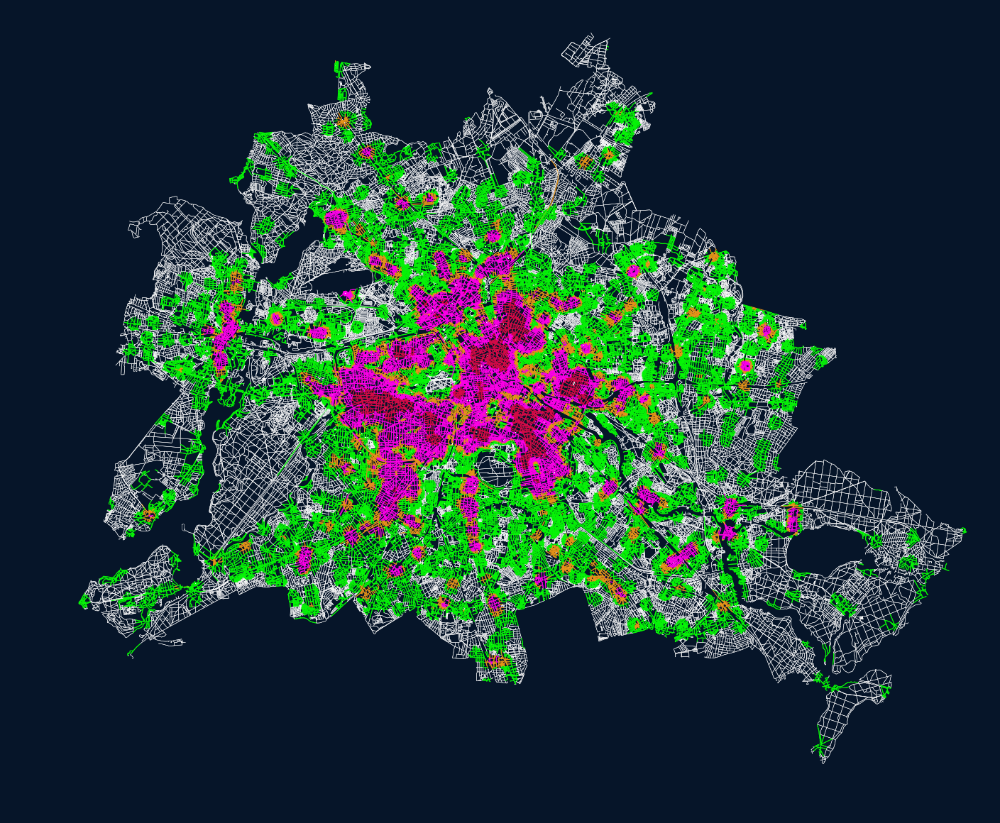

findfont: Font family ['Georgia'] not found. Falling back to DejaVu Sans.


CPU times: user 38.8 s, sys: 2.42 s, total: 41.2 s
Wall time: 42.9 s


In [12]:
%%time

# Center of map
latitude = 52.515720
longitude = 13.406059

# Bbox sides - Custom for each network
north = latitude + 0.17
south = latitude - 0.20
east = longitude + 0.37
west = longitude - 0.37

# Make Map
fig, ax = ox.plot_graph(G, node_size=0, bbox = (north, south, east, west), margin = 0,
                        fig_height=25, fig_width=25, dpi = 300,  bgcolor = "#061529",
                        save = False, edge_color=roadColors,
                        edge_linewidth=roadWidths, edge_alpha=1)


# Text and marker size
markersize = 20
fontsize = 20

# Add legend
legend_elements = [Line2D([0], [0], marker='s', color="#061529", label= 'Alcohol Potential [1,5] - Low',
                          markerfacecolor="#07f507", markersize=markersize),
                          
                  Line2D([0], [0], marker='s', color="#061529", label= 'Alcohol Potential [6,10] - Medium',
                         markerfacecolor="#e69419", markersize=markersize),
                  
                  Line2D([0], [0], marker='s', color="#061529", label= 'Alcohol Potential [10,50] - High',
                         markerfacecolor="#fc00e7", markersize=markersize),
                  
                  Line2D([0], [0], marker='s', color="#061529", label= 'Alcohol Potential > 50 Places',
                         markerfacecolor="#d40a47", markersize=markersize)]    
                      
l = ax.legend(handles=legend_elements, bbox_to_anchor=(0.0, 0.0), frameon=True, ncol=1,
              facecolor = '#061529', framealpha = 0.9,
              loc='lower left',  fontsize = fontsize, prop={'family':"Georgia", 'size':fontsize})  
  
# Legend font color
for text in l.get_texts():
    text.set_color("w")
    
# Save figure
fig.savefig(img_path_temp, dpi=300, bbox_inches='tight', format="png", facecolor=fig.get_facecolor(), transparent=True)


# Add border and text to map - check script utils.add_border

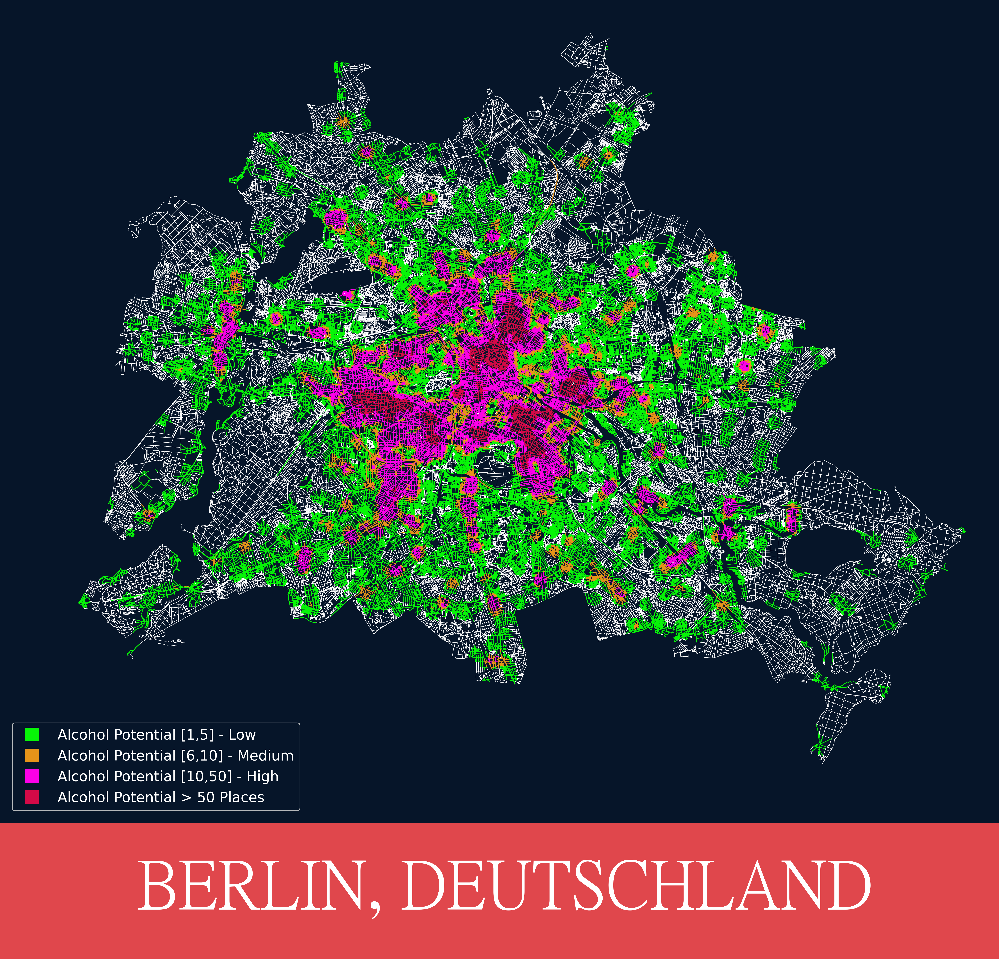

CPU times: user 12.7 s, sys: 250 ms, total: 13 s
Wall time: 13.5 s


In [13]:
%%time
# Output Image
add_border(img_path_temp, output_image=img_path_final, fill = '#e0474c', bottom = 800)

# Open Image
img = Image.open(img_path_final)
draw = ImageDraw.Draw(img)

# Get font from working directory. Visit https://www.wfonts.com/search?kwd=pmingliu to download fonts
font = ImageFont.truetype("PMINGLIU.ttf", 400)

# Add font: position, text, color, font
draw.text((800,5000),"BERLIN, DEUTSCHLAND", (255,255,255), font=font)

# Save image
img.save(img_path_final)

display(img)